<a href="https://colab.research.google.com/github/fcolombo7/AN2DL-2020/blob/main/Intro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [ ]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd

SEED = 1234
tf.random.set_seed(SEED)  

# Get current working directory
cwd = os.getcwd()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip '/content/drive/My Drive/ANN_project/artificial-neural-networks-and-deep-learning-2020.zip'

Output streaming troncato alle ultime 5000 righe.
  inflating: MaskDataset/training/10892.jpg  
  inflating: MaskDataset/training/10894.jpg  
  inflating: MaskDataset/training/10899.jpg  
  inflating: MaskDataset/training/10901.jpg  
  inflating: MaskDataset/training/10902.jpg  
  inflating: MaskDataset/training/10905.jpg  
  inflating: MaskDataset/training/10906.jpg  
  inflating: MaskDataset/training/10907.jpg  
  inflating: MaskDataset/training/10908.jpg  
  inflating: MaskDataset/training/10911.jpg  
  inflating: MaskDataset/training/10913.jpg  
  inflating: MaskDataset/training/10915.jpg  
  inflating: MaskDataset/training/10916.jpg  
  inflating: MaskDataset/training/10917.jpg  
  inflating: MaskDataset/training/10919.jpg  
  inflating: MaskDataset/training/10920.jpg  
  inflating: MaskDataset/training/10921.jpg  
  inflating: MaskDataset/training/10922.jpg  
  inflating: MaskDataset/training/10923.jpg  
  inflating: MaskDataset/training/10925.jpg  
  inflating: MaskDataset/train

In [ ]:
!ls

drive  MaskDataset  sample_data


In [ ]:
!ls MaskDataset/

test  train_gt.json  training


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

apply_data_augmentation = False

# Create training ImageDataGenerator object
if apply_data_augmentation:
    train_data_gen = ImageDataGenerator(rotation_range=10,
                                        width_shift_range=10,
                                        height_shift_range=10,
                                        zoom_range=0.3,
                                        horizontal_flip=True,
                                        vertical_flip=True,
                                        fill_mode='constant',
                                        cval=0,
                                        rescale=1./255)
else:
    train_data_gen = ImageDataGenerator(rescale=1./255)

# Create validation and test ImageDataGenerator objects
valid_data_gen = ImageDataGenerator(rescale=1./255)
test_data_gen = ImageDataGenerator(rescale=1./255)

In [ ]:
import json

img_h, img_w = (512, 512)
bs = 64

dataset_dir = os.path.join(cwd, "MaskDataset")
training_dir = os.path.join(dataset_dir, "training")
with open(os.path.join(dataset_dir,"train_gt.json")) as f:
  dic = json.load(f)
  dataframe = pd.DataFrame(dic.items())
  dataframe.rename(columns = {0:'filename', 1:'class'}, inplace = True)
  dataframe["class"] = dataframe["class"].astype('string')
  train_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=bs,
                                               target_size=(img_h, img_w),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED)

Found 5614 validated image filenames belonging to 3 classes.


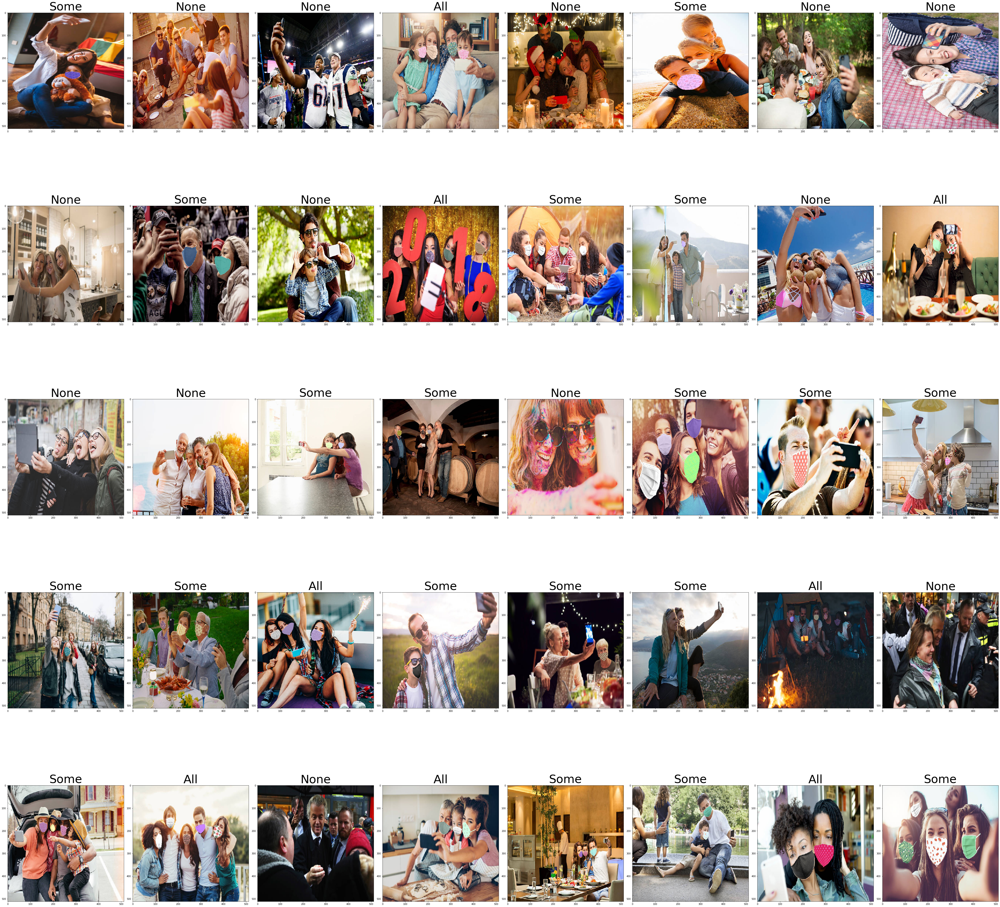

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

x_batch, y_batch = next(train_gen)

classes = np.array(["None", "All", "Some"])

axes=[]
fig=plt.figure(figsize=(60, 60))

for i in range(5*8):
    img = x_batch[i]
    axes.append( fig.add_subplot(5, 8, i+1) )
    subplot_title=(classes[y_batch[i].nonzero()][0])
    axes[-1].set_title(subplot_title, fontsize=50)  
    plt.imshow(img)
fig.tight_layout()    
plt.show();